# VISUALIZING RESULTS

## 1. MODEL ARCHITECTURE

In [81]:
import os

os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

import sys
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import random
import logging
from tqdm import tqdm
from torch.utils.data import DataLoader
from datasets.synapse_dataset import SynapseDataset
from utils import test_single_volume, calculate_metric_percase
import SimpleITK as sitk
from scipy.ndimage import zoom
from medpy import metric

In [48]:
seed = 1234
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)

In [49]:
print("GPU có sẵn:", torch.cuda.is_available())


GPU có sẵn: True


In [50]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Sử dụng thiết bị:", device)

Sử dụng thiết bị: cuda


In [51]:
from networks.vit_seg_modeling import VisionTransformer as ViT_seg
from networks.vit_seg_modeling import CONFIGS as CONFIGS_ViT_seg

In [52]:
def load_trained_model(snapshot_path, vit_name, img_size, num_classes, n_skip, vit_patches_size, is_pretrain=True):
    config_vit = CONFIGS_ViT_seg[vit_name]
    config_vit.n_classes = num_classes
    config_vit.n_skip = n_skip
    config_vit.patches.size = (vit_patches_size, vit_patches_size)
    if vit_name.find('R50') != -1:
        config_vit.patches.grid = (int(img_size / vit_patches_size), int(img_size / vit_patches_size))

    model = ViT_seg(config_vit, img_size=img_size, num_classes=num_classes)
    model = model.to(device)

    # Đường dẫn checkpoint ví dụ: epoch_(max_epochs-1).pth
    checkpoint = os.path.join(snapshot_path, 'epoch_4.pth')  # Cập nhật theo checkpoint của bạn
    if not os.path.exists(checkpoint):
        raise FileNotFoundError(f"Checkpoint file không tồn tại: {checkpoint}")
    state_dict = torch.load(checkpoint, map_location=device, weights_only=True)
    model.load_state_dict(state_dict)
    print("Load model thành công từ:", checkpoint)
    return model

In [53]:
snapshot_path = "../model/TU_synapse224/TU_pretrain_R50-ViT-B_16_skip2_epo5_bs2_224"
vit_name = "R50-ViT-B_16"
img_size = 224
num_classes = 9
n_skip = 2
vit_patches_size = 16

In [54]:
model = load_trained_model(snapshot_path, vit_name, img_size, num_classes, n_skip, vit_patches_size)

Load model thành công từ: ../model/TU_synapse224/TU_pretrain_R50-ViT-B_16_skip2_epo5_bs2_224\epoch_4.pth


---

In [66]:
volume_path = "../data_test/synapse/test"  # Đường dẫn đến dữ liệu test
list_dir = "../data_test/synapse/list"  # Thư mục chứa danh sách case
num_classes = 8  # Số lớp segmentation
img_size = 224  # Kích thước ảnh đầu vào
z_spacing = 1.0  # Z spacing để lưu ảnh
test_save_path = None  # Có thể đặt đường dẫn nếu muốn lưu kết quả

In [67]:
test_dataset = SynapseDataset(base_dir=volume_path, split="test", list_dir=list_dir)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=1)

In [68]:
print("Số ca test:", len(test_dataset))

Số ca test: 12


In [69]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
model.eval()

VisionTransformer(
  (transformer): Transformer(
    (embeddings): Embeddings(
      (hybrid_model): ResNetV2(
        (root): Sequential(
          (conv): StdConv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
          (gn): GroupNorm(32, 64, eps=1e-06, affine=True)
          (relu): ReLU(inplace=True)
        )
        (body): Sequential(
          (block1): Sequential(
            (unit1): PreActBottleneck(
              (gn1): GroupNorm(32, 64, eps=1e-06, affine=True)
              (conv1): StdConv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (gn2): GroupNorm(32, 64, eps=1e-06, affine=True)
              (conv2): StdConv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
              (gn3): GroupNorm(32, 256, eps=1e-06, affine=True)
              (conv3): StdConv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (relu): ReLU(inplace=True)
              (downsample): StdConv2d(64, 256, 

In [109]:
def plot_case_and_class_metrics(case_names, case_metrics, class_names, overall_metrics = None):
    num_cases = len(case_names)
    num_classes = len(class_names)

    case_metrics = np.array(case_metrics)

    dice_matrix = case_metrics[:, :, 0]
    hd95_matrix = case_metrics[:, :, 1]

    fig, ax = plt.subplots(1, 2, figsize=(14, 6))
    indices = np.arange(num_cases)
    bar_width = 0.8 / num_classes

    for j in range(num_classes):
        ax[0].bar(indices + j * bar_width, dice_matrix[:, j], bar_width, label=class_names[j])
    ax[0].set_xlabel("Case")
    ax[0].set_ylabel("Dice Score")
    ax[0].set_title("Dice Score theo Case và theo Class")
    ax[0].set_xticks(indices + bar_width * (num_classes - 1) / 2)
    ax[0].set_xticklabels(case_names, rotation=45, ha="right")
    ax[0].legend(title="Class")
    ax[0].grid(True, axis="y", linestyle="--", alpha=0.7)

    for j in range(num_classes):
        ax[1].bar(indices + j * bar_width, hd95_matrix[:, j], bar_width, label=class_names[j])
    ax[1].set_xlabel("Case")
    ax[1].set_ylabel("HD95")
    ax[1].set_title("HD95 theo Case và theo Class")
    ax[1].set_xticks(indices + bar_width * (num_classes - 1) / 2)
    ax[1].set_xticklabels(case_names, rotation=45, ha="right")
    ax[1].legend(title="Class")
    ax[1].grid(True, axis="y", linestyle="--", alpha=0.7)

    plt.tight_layout()
    plt.show()

    if overall_metrics is not None:
        overall_metrics = np.array(overall_metrics)  # shape (num_classes, 2)
        overall_dice = overall_metrics[:, 0]
        overall_hd95 = overall_metrics[:, 1]

        fig2, ax2 = plt.subplots(1, 2, figsize=(12, 6))
        ax2[0].bar(np.arange(num_classes), overall_dice, color="skyblue")
        ax2[0].set_xticks(np.arange(num_classes))
        ax2[0].set_xticklabels(class_names, rotation=45, ha="right")  # xoay nhãn trục Ox
        ax2[0].set_ylabel("Mean Dice Score")
        ax2[0].set_title("Mean Dice Score theo Class")
        ax2[0].grid(True, axis="y", linestyle="--", alpha=0.7)

        ax2[1].bar(np.arange(num_classes), overall_hd95, color="salmon")
        ax2[1].set_xticks(np.arange(num_classes))
        ax2[1].set_xticklabels(class_names, rotation=45, ha="right")  # xoay nhãn trục Ox
        ax2[1].set_ylabel("Mean HD95")
        ax2[1].set_title("Mean HD95 theo Class")
        ax2[1].grid(True, axis="y", linestyle="--", alpha=0.7)

        plt.tight_layout()
        plt.show()


In [110]:
class_names = ["Aorta", "Gallbladder", "Left Kidney", "Right Kidney", "Liver", "Pancreas", "Sleepen", "Stomach"]

In [ ]:
metric_list = []
case_names = []

for i_batch, sampled_batch in tqdm(enumerate(test_loader), total=len(test_loader)):
    image = sampled_batch["image"].to(device)
    label = sampled_batch["label"].to(device)
    case_name = sampled_batch["case_name"][0]
    case_names.append(case_name)

    # Hàm test_single_volume trả về metric cho từng class (shape: (num_classes, 2))
    metric_i = test_single_volume(
        image, label, model, classes=num_classes,
        patch_size=[img_size, img_size], test_save_path=test_save_path,
        case=case_name, z_spacing=z_spacing
    )

    metric_i = np.array(metric_i)  # Đảm bảo metric_i là numpy array
    if metric_i.shape[0] != num_classes:
        print(f"⚠️ Warning: Số lớp không khớp trong case {case_name} ({metric_i.shape[0]} lớp)")

    metric_list.append(metric_i)  # Lưu dữ liệu từng case

    # Hiển thị thông tin từng case
    mean_dice = np.mean(metric_i[:, 0])  # Lấy trung bình cột Dice
    mean_hd95 = np.mean(metric_i[:, 1])  # Lấy trung bình cột HD95
    print(f"\nCase {case_name}: Mean Dice = {mean_dice:.4f}, Mean HD95 = {mean_hd95:.4f}")

# Chuyển metric_list thành numpy array để xử lý dễ dàng hơn
metric_list = np.array(metric_list)  # shape: (num_cases, num_classes, 2)

  0%|          | 0/12 [00:00<?, ?it/s]

In [70]:
overall_metrics = np.mean(np.array(metric_list), axis=0)
print(overall_metrics)

[[ 0.76490243 27.36619879]
 [ 0.          0.        ]
 [ 0.67214765 40.26639344]
 [ 0.66559735 57.64954853]
 [ 0.88316265 48.1648199 ]
 [ 0.23322615 41.76250234]
 [ 0.73962792 23.27051608]
 [ 0.56412346 26.37538787]]


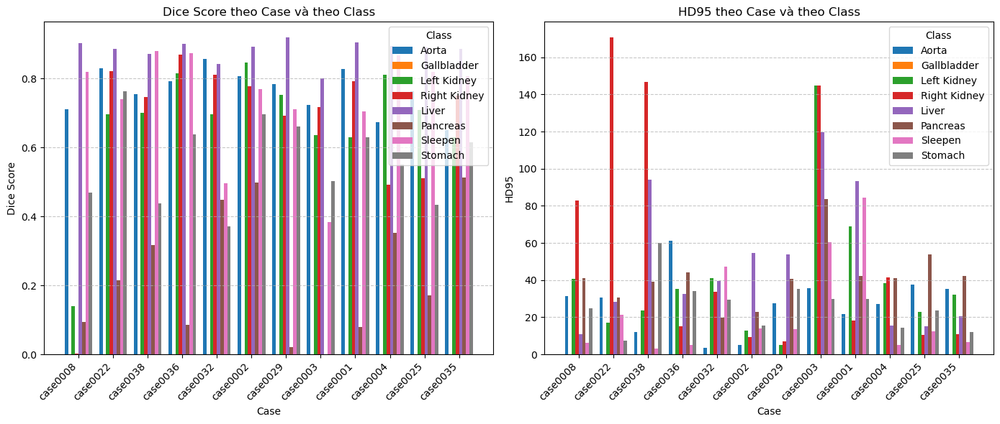

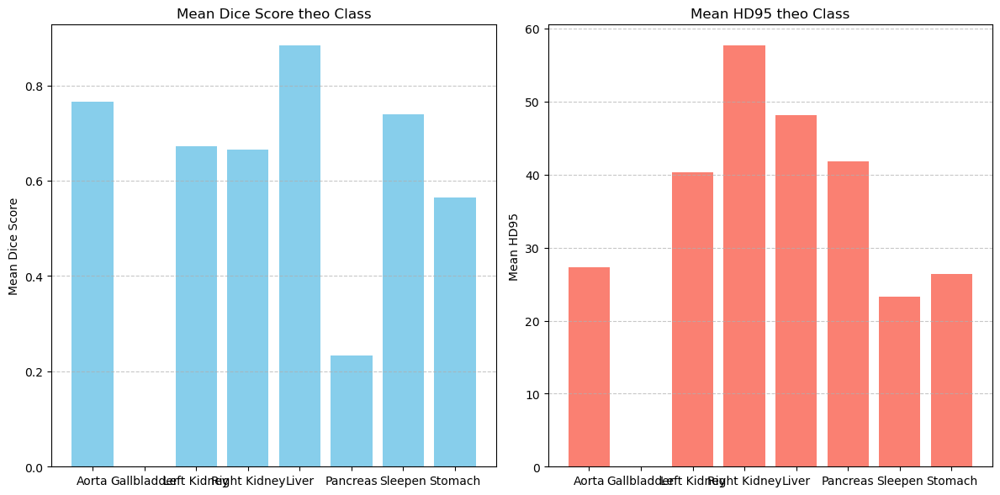

In [71]:
plot_case_and_class_metrics(case_names, metric_list, class_names[1:], overall_metrics=overall_metrics)

In [72]:
# Chuyển metric_list thành numpy array để xử lý dễ dàng hơn
metric_list = np.array(metric_list)  # shape: (num_cases, num_classes, 2)

# Kiểm tra shape
num_cases, num_classes, _ = metric_list.shape
print(f"\nSố case: {num_cases}, Số class: {num_classes}")

# Tính trung bình Dice và HD95 theo từng class
mean_metrics = np.mean(metric_list, axis=0)  # shape: (num_classes, 2)

# In kết quả theo từng class
print("\n==== Mean Dice & Mean HD95 per Class ====")
for i in range(num_classes):
    dice_value = mean_metrics[i, 0]  # Mean Dice của class i
    hd95_value = mean_metrics[i, 1]  # Mean HD95 của class i
    print(f"Class {class_names[i]}: Mean Dice = {dice_value:.4f}, Mean HD95 = {hd95_value:.4f}")


Số case: 12, Số class: 8

==== Mean Dice & Mean HD95 per Class ====
Class Background: Mean Dice = 0.7649, Mean HD95 = 27.3662
Class Aorta: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class Gallbladder: Mean Dice = 0.6721, Mean HD95 = 40.2664
Class Left Kidney: Mean Dice = 0.6656, Mean HD95 = 57.6495
Class Right Kidney: Mean Dice = 0.8832, Mean HD95 = 48.1648
Class Liver: Mean Dice = 0.2332, Mean HD95 = 41.7625
Class Pancreas: Mean Dice = 0.7396, Mean HD95 = 23.2705
Class Sleepen: Mean Dice = 0.5641, Mean HD95 = 26.3754


In [78]:
mean_metrics = np.mean(metric_list, axis=(0, 1))  # Lấy trung bình trên tất cả case và class
performance = float(mean_metrics[0])
mean_hd95 = float(mean_metrics[1])

print(f"Overall Performance: Mean Dice = {performance:.4f}, Mean HD95 = {mean_hd95:.4f}")


Overall Performance: Mean Dice = 0.5653, Mean HD95 = 33.1069


---

In [105]:
def visualize_prediction(image, label, prediction, case_name="Sample Case"):
    """
    Hiển thị ảnh gốc, nhãn thực tế và ảnh dự đoán cạnh nhau.
    """
    plt.figure(figsize=(12, 4))

    # Ảnh gốc (chuyển về grayscale nếu cần)
    plt.subplot(1, 3, 1)
    plt.imshow(image[0, 0].cpu().numpy(), cmap='gray')  # Chọn kênh đầu tiên nếu là ảnh 3D
    plt.title(f"Original Image\n{case_name}")
    plt.axis("off")

    # Ground Truth (truy cập trực tiếp kênh đầu tiên vì nhãn đã ở dạng cứng)
    plt.subplot(1, 3, 2)
    plt.imshow(label[0, 0].cpu().numpy(), cmap="jet")
    plt.title("Ground Truth")
    plt.axis("off")

    # Prediction
    plt.subplot(1, 3, 3)
    plt.imshow(prediction, cmap="jet")
    plt.title("Predicted Segmentation")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

Original Image Shape: torch.Size([1, 148, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 148, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0008
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


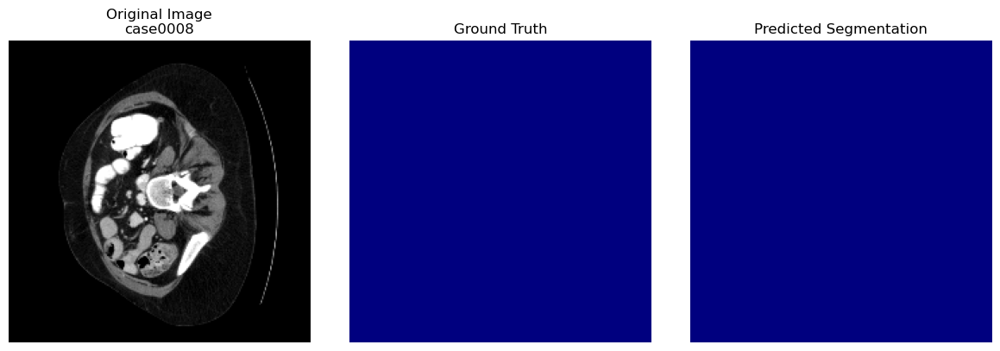

Original Image Shape: torch.Size([1, 89, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 89, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0022
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


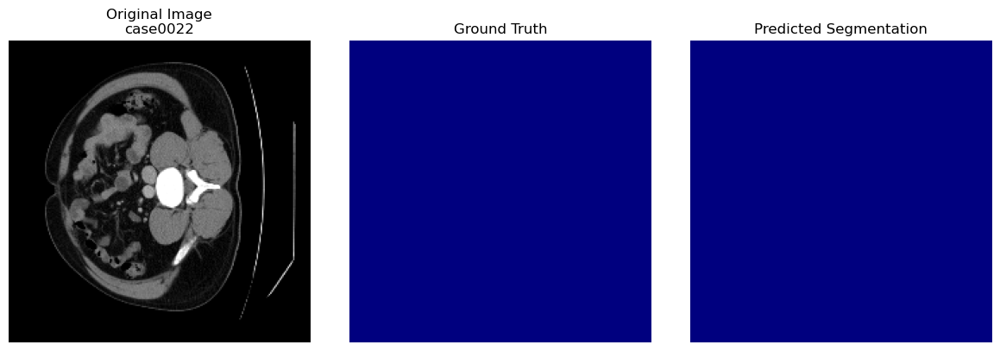

Original Image Shape: torch.Size([1, 100, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 100, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0038
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


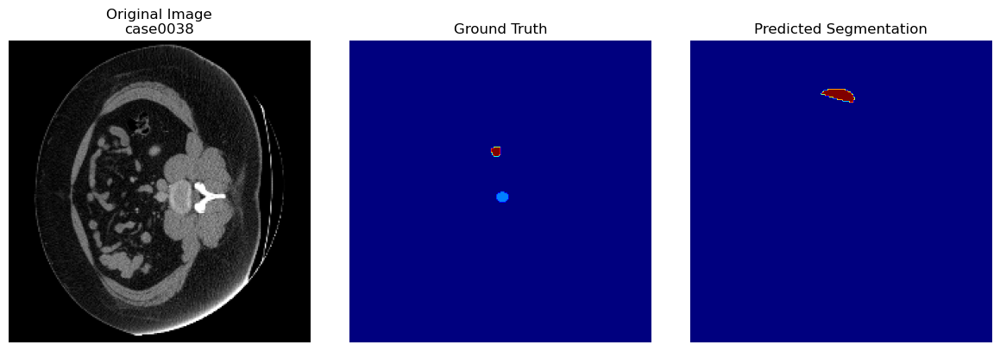

Original Image Shape: torch.Size([1, 184, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 184, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0036
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


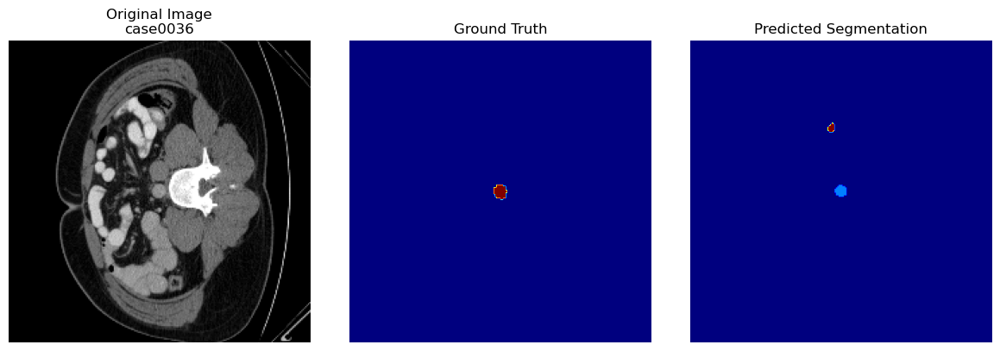

Original Image Shape: torch.Size([1, 144, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 144, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0032
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


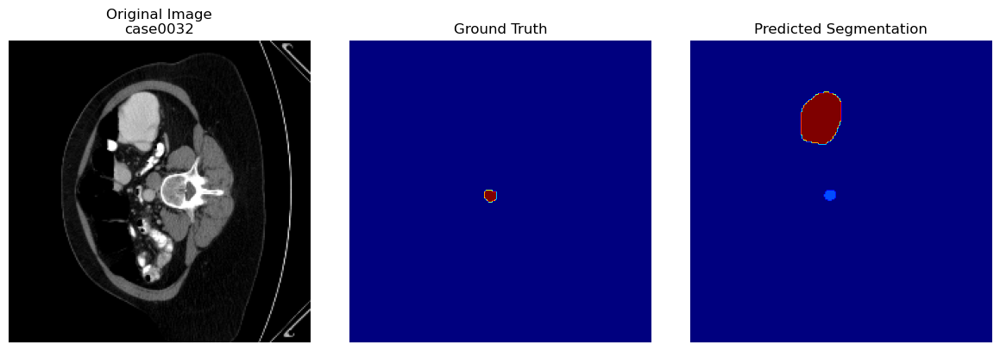

Original Image Shape: torch.Size([1, 139, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 139, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0002
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


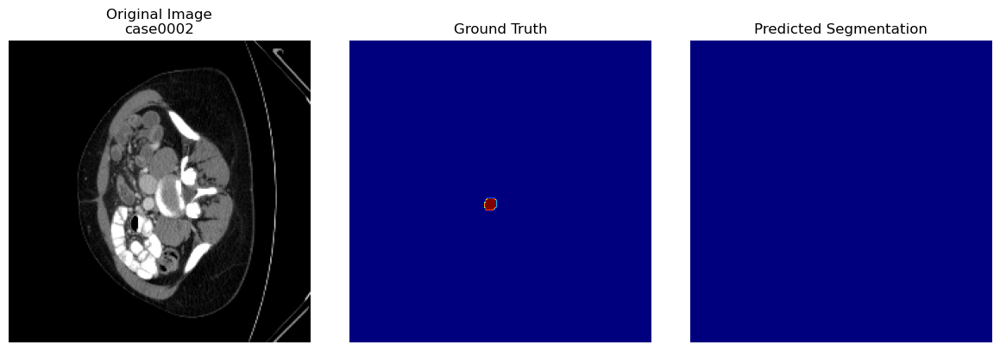

Original Image Shape: torch.Size([1, 100, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 100, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0029
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


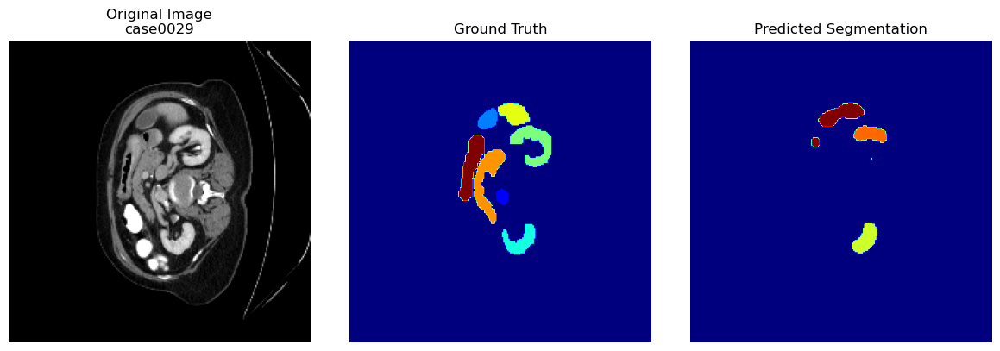

Original Image Shape: torch.Size([1, 198, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 198, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0003
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


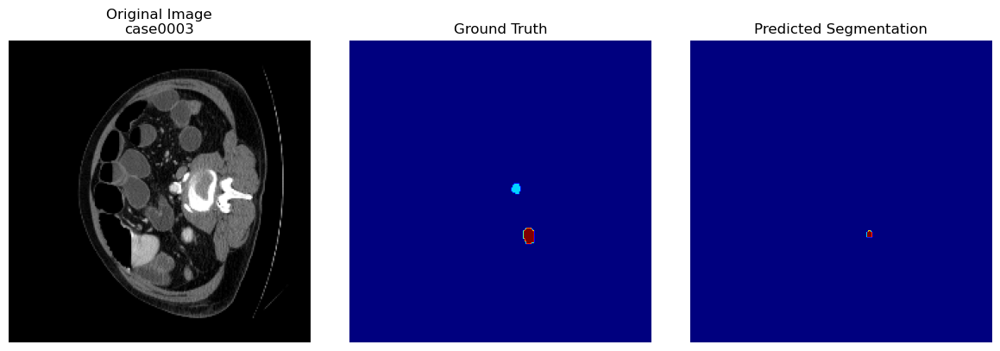

Original Image Shape: torch.Size([1, 147, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 147, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0001
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


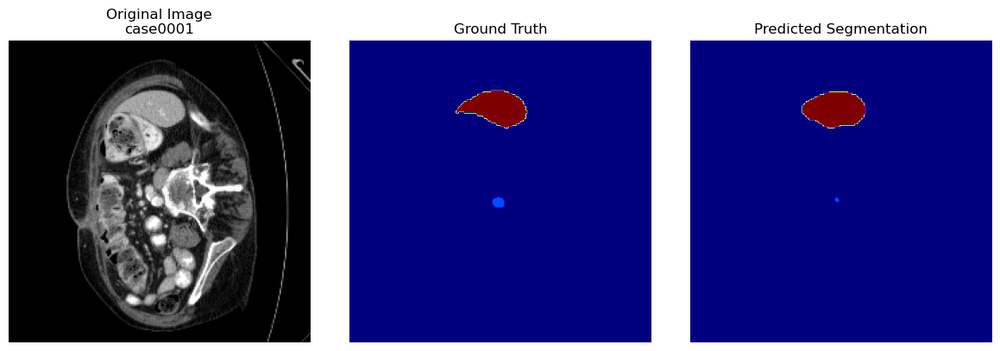

Original Image Shape: torch.Size([1, 140, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 140, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0004
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


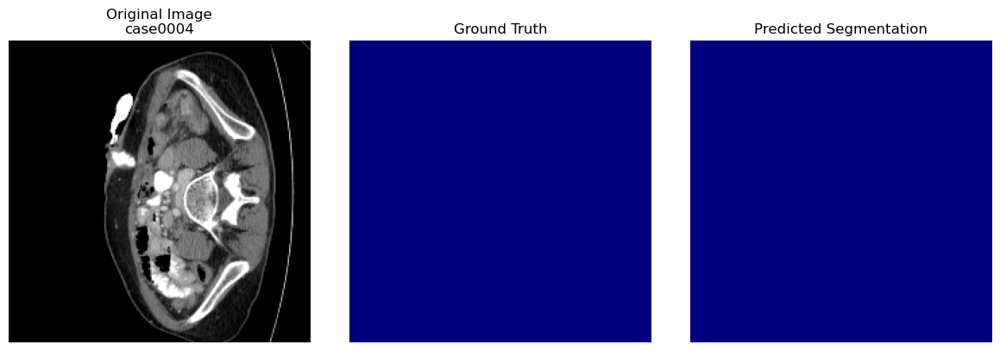

Original Image Shape: torch.Size([1, 85, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 85, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0025
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


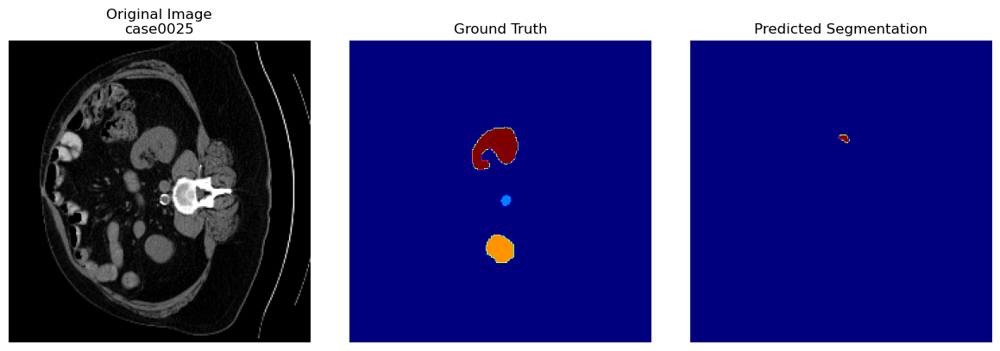

Original Image Shape: torch.Size([1, 94, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 94, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0035
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


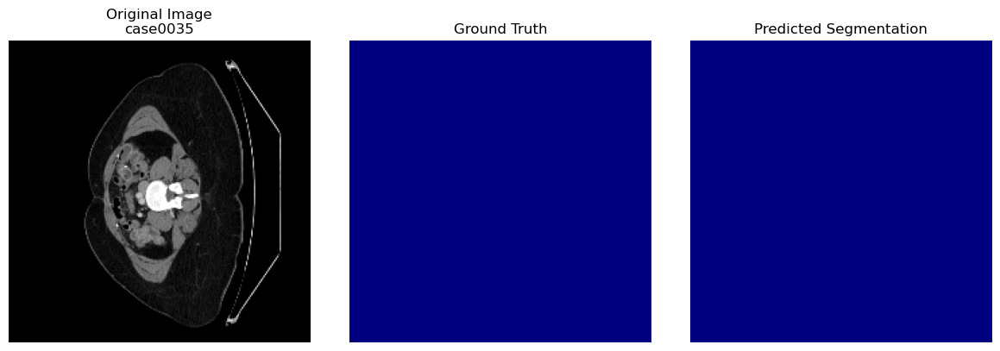

In [106]:
with torch.no_grad():
    for sample in test_loader:
        try:
            image = sample["image"].to(device)  # Ảnh gốc
            label = sample["label"].to(device)  # Ground Truth
            case_name = sample["case_name"][0]

            print("Original Image Shape:", image.shape, "Type:", image.dtype)
            print("Original Label Shape:", label.shape, "Type:", label.dtype)

            # Xử lý ảnh 3D (D = depth)
            if image.dim() == 4:
                slice_idx = image.shape[1] // 2  # Lấy lát cắt giữa
                image = image[:, slice_idx, :, :].unsqueeze(1)  # (B, 1, H, W)
                label = label[:, slice_idx, :, :].unsqueeze(1)  # (B, 1, H, W)

            image = image.float()

            # Resize ảnh và nhãn về 224x224 để phù hợp với grid-size 14x14
            image = F.interpolate(image, size=(224, 224), mode="bilinear", align_corners=False)
            label = F.interpolate(label.float(), size=(224, 224), mode="nearest").long()

            print("Processed Image Shape:", image.shape, "Type:", image.dtype)
            print("Processed Label Shape:", label.shape, "Type:", label.dtype)

            # Dự đoán với mô hình
            output = model(image)

            # Xử lý kết quả dự đoán: prediction đã có shape (224,224)
            pred = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()

            print(f"Case: {case_name}")
            print("Output Shape:", output.shape)
            print("Pred Shape:", pred.shape)

            visualize_prediction(image, label, pred, case_name)

        except Exception as e:
            print(f"Lỗi xảy ra với case {case_name}: {str(e)}")

In [107]:
def overlay_segmentation(image, segmentation, alpha=0.5):
    """
    Overlay segmentation lên ảnh gốc với hiệu ứng trong suốt.
    image: tensor có shape (1, 1, H, W)
    segmentation: mảng numpy có shape (H, W)
    """
    # Lấy ảnh gốc từ tensor
    img = image[0, 0].cpu().numpy()
    seg = segmentation.astype(np.uint8)

    # Chuẩn hóa ảnh về khoảng 0-255
    img = ((img - img.min()) / (img.max() - img.min()) * 255).astype(np.uint8)

    # Chuyển nhãn thành ảnh màu. (Điều chỉnh hệ số nhân nếu cần cho số lớp khác nhau)
    seg_color = cv2.applyColorMap(seg * 30, cv2.COLORMAP_JET)

    # Chuyển ảnh grayscale sang RGB
    img_color = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

    # Overlay bằng alpha blending
    blended = cv2.addWeighted(img_color, 1 - alpha, seg_color, alpha, 0)

    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(blended, cv2.COLOR_BGR2RGB))
    plt.title("Overlay Segmentation")
    plt.axis("off")
    plt.show()

Original Image Shape: torch.Size([1, 148, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 148, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0008
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


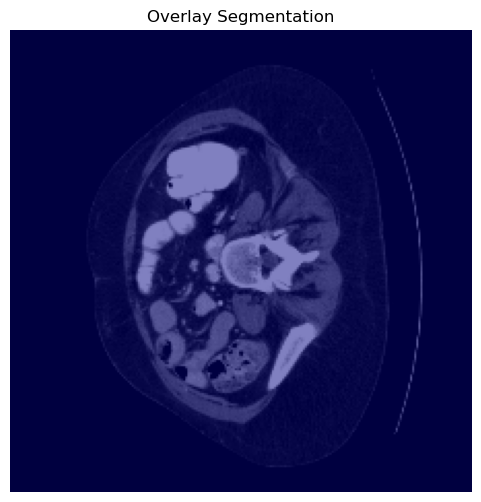

Original Image Shape: torch.Size([1, 89, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 89, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0022
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


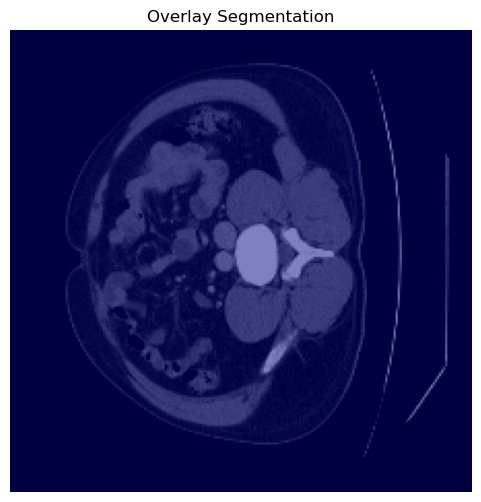

Original Image Shape: torch.Size([1, 100, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 100, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0038
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


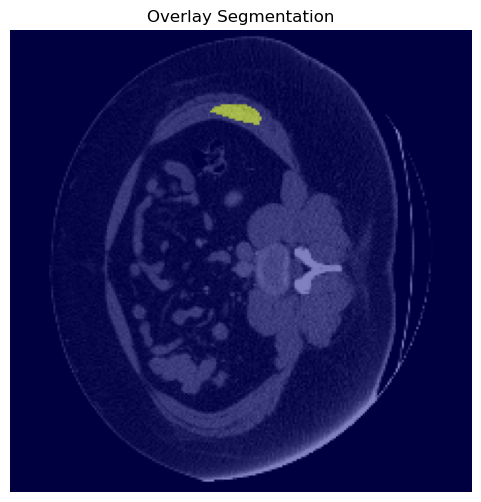

Original Image Shape: torch.Size([1, 184, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 184, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0036
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


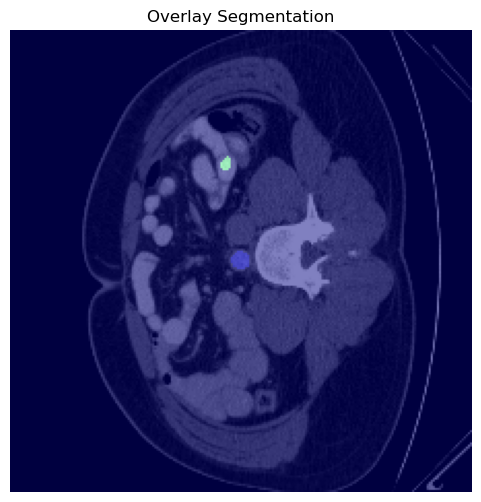

Original Image Shape: torch.Size([1, 144, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 144, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0032
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


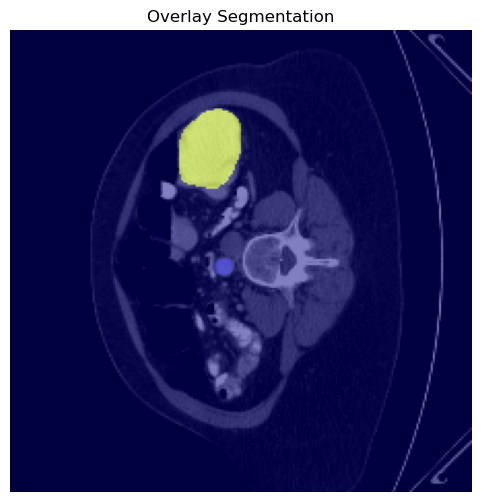

Original Image Shape: torch.Size([1, 139, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 139, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0002
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


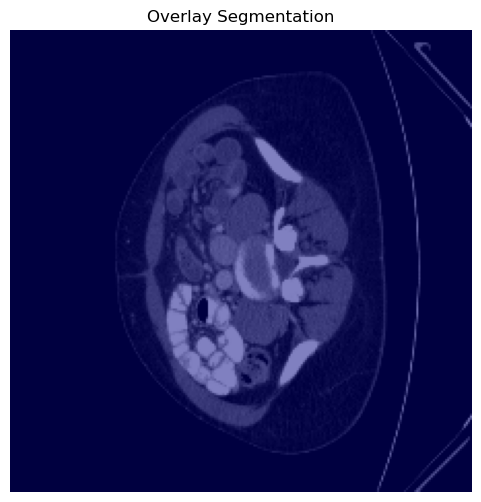

Original Image Shape: torch.Size([1, 100, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 100, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0029
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


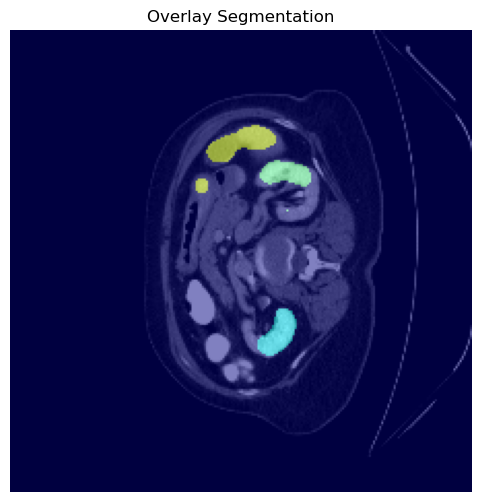

Original Image Shape: torch.Size([1, 198, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 198, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0003
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


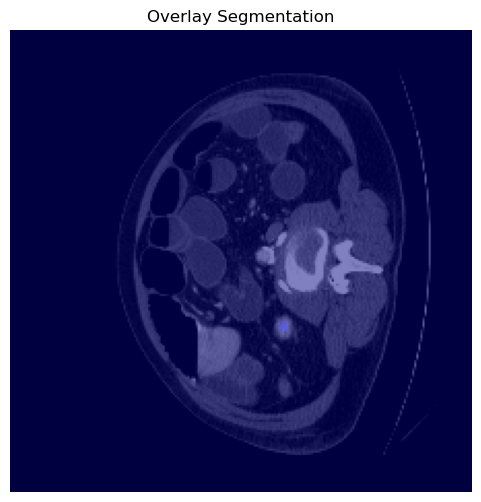

Original Image Shape: torch.Size([1, 147, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 147, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0001
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


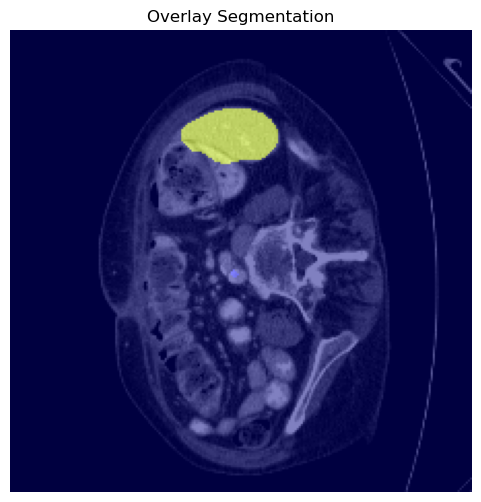

Original Image Shape: torch.Size([1, 140, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 140, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0004
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


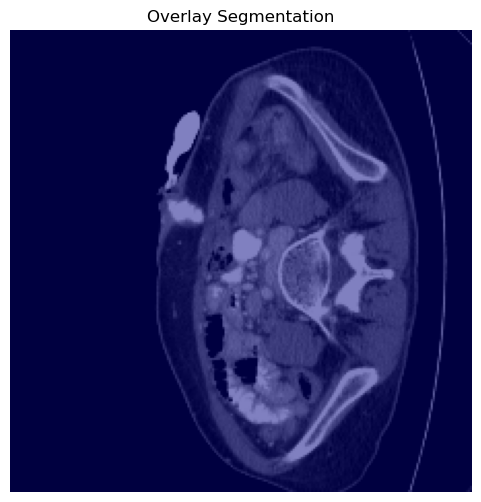

Original Image Shape: torch.Size([1, 85, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 85, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0025
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


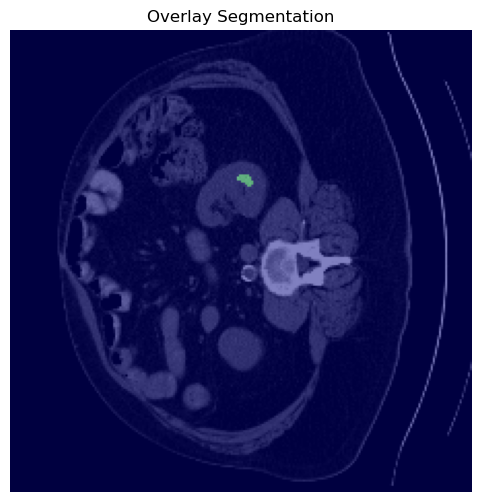

Original Image Shape: torch.Size([1, 94, 512, 512]) Type: torch.float32
Original Label Shape: torch.Size([1, 94, 512, 512]) Type: torch.uint8
Processed Image Shape: torch.Size([1, 1, 224, 224]) Type: torch.float32
Processed Label Shape: torch.Size([1, 1, 224, 224]) Type: torch.int64
Case: case0035
Output Shape: torch.Size([1, 9, 224, 224])
Pred Shape: (224, 224)


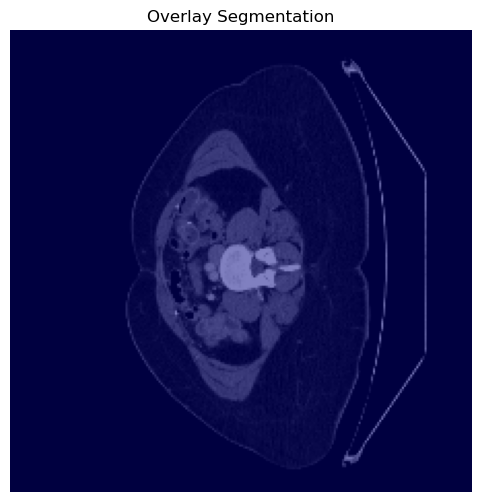

In [108]:
# Duyệt qua các mẫu trong test_loader và thực hiện overlay segmentation
with torch.no_grad():
    for sample in test_loader:
        try:
            # Lấy ảnh, nhãn và tên case
            image = sample["image"].to(device)  # (B, D, H, W)
            label = sample["label"].to(device)  # (B, D, H, W)
            case_name = sample["case_name"][0]

            # In thông tin shape
            print("Original Image Shape:", image.shape, "Type:", image.dtype)
            print("Original Label Shape:", label.shape, "Type:", label.dtype)

            # Xử lý ảnh 3D: chọn lát cắt giữa
            if image.dim() == 4:
                slice_idx = image.shape[1] // 2
                image = image[:, slice_idx, :, :].unsqueeze(1)  # (B, 1, H, W)
                label = label[:, slice_idx, :, :].unsqueeze(1)    # (B, 1, H, W)

            image = image.float()

            # Resize ảnh và nhãn về 224x224 (phù hợp với mô hình)
            image = F.interpolate(image, size=(224, 224), mode="bilinear", align_corners=False)
            label = F.interpolate(label.float(), size=(224, 224), mode="nearest").long()

            print("Processed Image Shape:", image.shape, "Type:", image.dtype)
            print("Processed Label Shape:", label.shape, "Type:", label.dtype)

            # Dự đoán với mô hình
            output = model(image)
            # Xử lý kết quả dự đoán: lấy argmax và chuyển về numpy
            pred = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()
            print(f"Case: {case_name}")
            print("Output Shape:", output.shape)
            print("Pred Shape:", pred.shape)

            # Overlay segmentation lên ảnh gốc với kết quả dự đoán
            overlay_segmentation(image, pred, alpha=0.5)

        except Exception as e:
            print(f"Lỗi xảy ra với case {case_name}: {str(e)}")

---

In [91]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

In [92]:
label_names = {
    0: "Background",
    1: "Aorta",
    2: "Gallbladder",
    3: "Left Kidney",
    4: "Right Kidney",
    5: "Liver",
    6: "Pancreas",
    7: "Sleepen",
    8: "Stomach"
}

In [93]:
def load_nii(file_path):
    nii = nib.load(file_path)
    return nii.get_fdata()

In [94]:
def get_legend_handles(label_names, cmap):
    """
    Tạo danh sách các Patch dùng để làm legend.
    """
    handles = []
    # Lấy số lớp tối đa từ dictionary
    for label, name in label_names.items():
        # cmap(label) trả về màu của lớp label
        handles.append(Patch(facecolor=cmap(label), label=name))
    return handles

In [103]:
def visualize_all_slices_in_groups(image, ground_truth, prediction, label_names=None, n_cols=10):
    total_slices = image.shape[2]
    n_groups = int(np.ceil(total_slices / n_cols))

    # Nếu có label_names, xác định số lớp và tạo discrete colormap
    if label_names is not None:
        num_classes = max(label_names.keys()) + 1
        seg_cmap = plt.get_cmap('tab20', num_classes)
    else:
        seg_cmap = "jet"  # dùng jet mặc định nếu không có label_names

    for group in range(n_groups):
        start = group * n_cols
        end = min((group + 1) * n_cols, total_slices)
        current_slices = range(start, end)

        cols = len(current_slices)
        # Tăng kích thước figure để các subplot không quá chật
        fig, axes = plt.subplots(3, cols, figsize=(cols * 4, 12))

        # Nếu chỉ có 1 cột, đảm bảo axes là mảng 2 chiều
        if cols == 1:
            axes = np.expand_dims(axes, axis=1)

        for i, slice_idx in enumerate(current_slices):
            # Hàng 0: Ảnh gốc
            axes[0, i].imshow(image[:, :, slice_idx], cmap="gray")
            axes[0, i].set_title(f"Slice {slice_idx}", fontsize=10)
            # Thêm chú thích trực tiếp trên ảnh (ở góc trên bên trái)
            axes[0, i].text(0.02, 0.95, "Input (Ảnh gốc)", transform=axes[0, i].transAxes,
                            fontsize=10, color='yellow', backgroundcolor='black')
            axes[0, i].axis("off")

            # Hàng 1: Ảnh gốc + Ground Truth
            axes[1, i].imshow(image[:, :, slice_idx], cmap="gray")
            if label_names is not None:
                axes[1, i].imshow(ground_truth[:, :, slice_idx], cmap=seg_cmap,
                                  vmin=0, vmax=num_classes-1, alpha=0.6)
            else:
                axes[1, i].imshow(ground_truth[:, :, slice_idx], cmap="jet", alpha=0.6)
            axes[1, i].text(0.02, 0.95, "Ground Truth", transform=axes[1, i].transAxes,
                            fontsize=10, color='yellow', backgroundcolor='black')
            axes[1, i].axis("off")

            # Hàng 2: Ảnh gốc + Prediction
            axes[2, i].imshow(image[:, :, slice_idx], cmap="gray")
            if label_names is not None:
                axes[2, i].imshow(prediction[:, :, slice_idx], cmap=seg_cmap,
                                  vmin=0, vmax=num_classes-1, alpha=0.6)
            else:
                axes[2, i].imshow(prediction[:, :, slice_idx], cmap="jet", alpha=0.6)
            axes[2, i].text(0.02, 0.95, "Prediction", transform=axes[2, i].transAxes,
                            fontsize=10, color='yellow', backgroundcolor='black')
            axes[2, i].axis("off")

        # Nếu có label_names, thêm legend bên ngoài figure
        if label_names is not None:
            handles = get_legend_handles(label_names, seg_cmap)
            fig.legend(handles=handles, loc='lower center', ncol=len(label_names), fontsize=10)
            fig.subplots_adjust(bottom=0.15)

        plt.tight_layout(rect=[0, 0.05, 1, 1])
        plt.show()


img shape: (512, 512, 139)
gt shape: (512, 512, 139)
pred shape: (512, 512, 139)


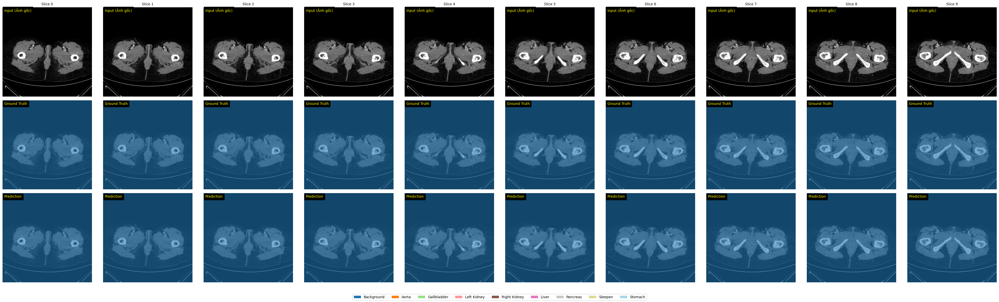

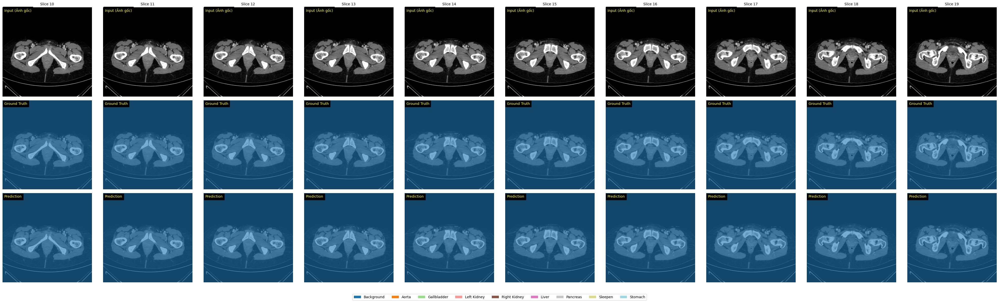

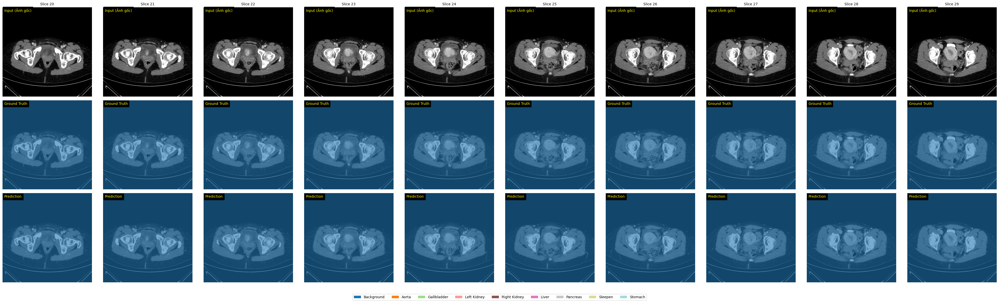

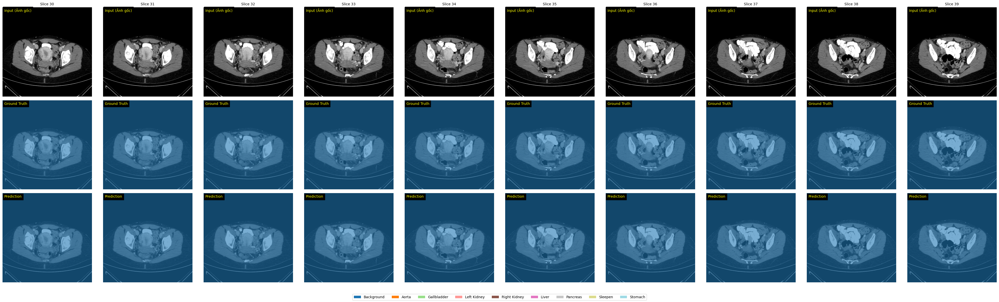

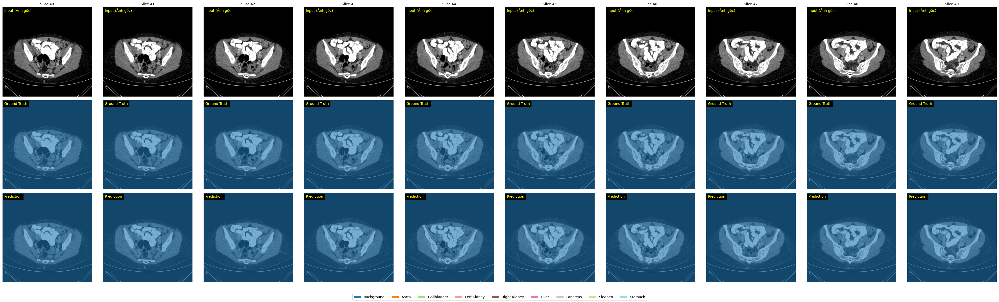

...

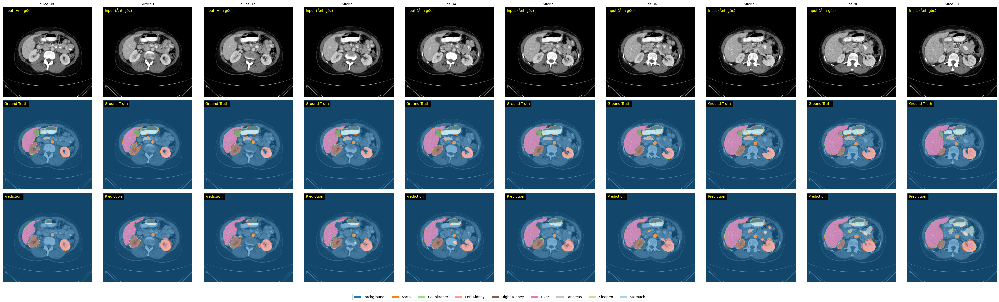

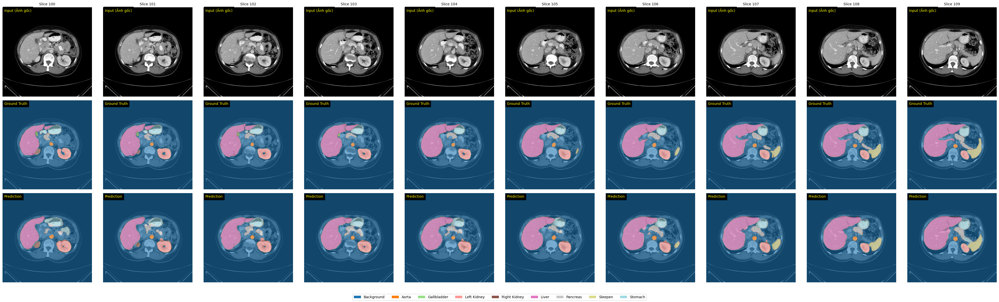

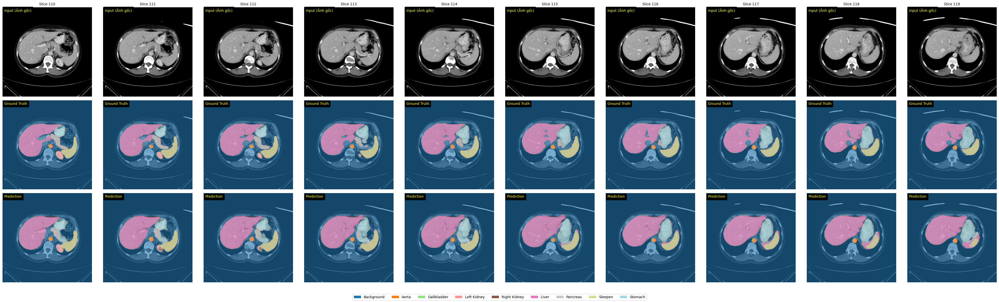

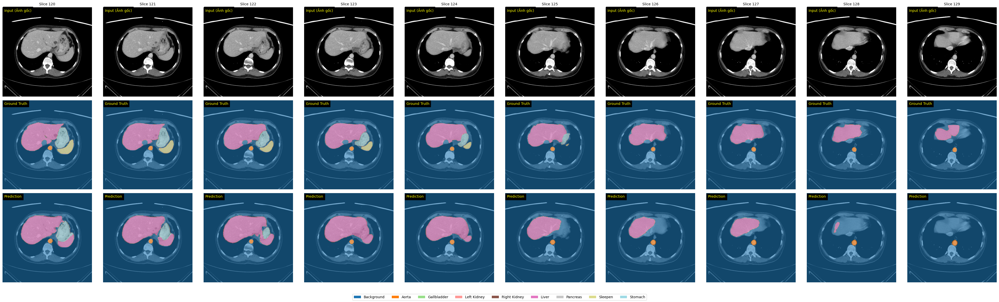

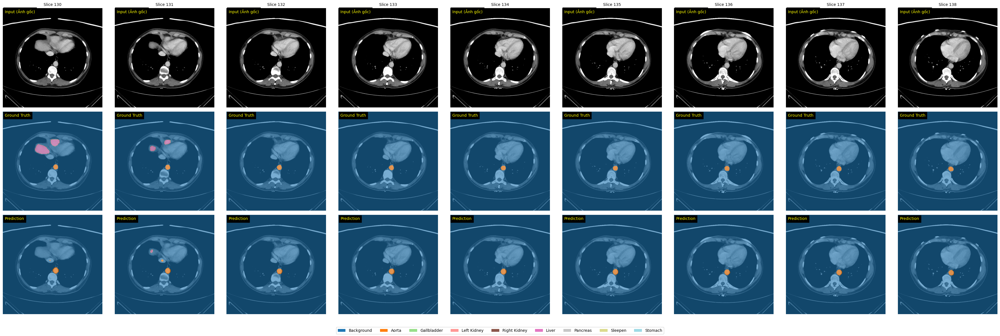

In [104]:
base_dir = "predictions/TU_synapse224/TU_pretrain_R50-ViT-B_16_skip2_epo5_bs2_224"
case_id = "case0002"  # Thay bằng ID case cần xem
img_path = os.path.join(base_dir, f"{case_id}_img.nii.gz")
gt_path = os.path.join(base_dir, f"{case_id}_gt.nii.gz")
pred_path = os.path.join(base_dir, f"{case_id}_pred.nii.gz")

img = load_nii(img_path)
gt = load_nii(gt_path)
pred = load_nii(pred_path)

print("img shape:", img.shape)
print("gt shape:", gt.shape)
print("pred shape:", pred.shape)

visualize_all_slices_in_groups(img, gt, pred, label_names=label_names, n_cols=10)